# Ninjacart Case Study

## About Ninjacart

Ninjacart is India's largest fresh produce supply chain company. They are pioneers in solving one of the toughest supply chain problems of the world by leveraging innovative technology. They source fresh produce from farmers and deliver them to businesses within 12 hours. An integral component of their automation process is the development of robust classifiers which can distinguish between images of different types of vegetables, while also correctly labeling images that do not contain any one type of vegetable as noise.

## Problem statement

As a starting point, ninjacart has provided us with a dataset scraped from the web which contains train and test folders, each having 4 sub-folders with images of onions, potatoes, tomatoes and some market scenes. We have been tasked with preparing a multiclass classifier for identifying these vegetables. The dataset provided has all the required images to achieve the task.

## Objective

The objective is to develop a program that can recognize the vegetable item(s) in a photo and identify them for the user.

## Data

This dataset contains images of the following food items: noise-Indian market and images of vegetables- onion, potato and tomato.

The train data contains the following number of images<br>
Tomato : 789<br>
Potato : 898<br>
Onion : 849<br>
Indian market : 599<br>

The train data contains the following number of images<br>
Tomato : 106<br>
potato : 83<br>
onion : 81<br>
Indian market : 81<br>




#### Downloading and unzipping raw data

In [1]:
!gdown 1clZX-lV_MLxKHSyeyTheX5OCQtNCUcqT

Downloading...
From: https://drive.google.com/uc?id=1clZX-lV_MLxKHSyeyTheX5OCQtNCUcqT
To: /content/ninjacart_data.zip
100% 275M/275M [00:10<00:00, 26.8MB/s]


In [2]:
!unzip /content/ninjacart_data.zip

Archive:  /content/ninjacart_data.zip
   creating: ninjacart_data/test/
   creating: ninjacart_data/test/indian market/
  inflating: ninjacart_data/test/indian market/bhl.jpeg  
  inflating: ninjacart_data/test/indian market/bhv.jpeg  
  inflating: ninjacart_data/test/indian market/bn.jpeg  
  inflating: ninjacart_data/test/indian market/hjx.jpeg  
  inflating: ninjacart_data/test/indian market/igis.jpeg  
  inflating: ninjacart_data/test/indian market/in.jpeg  
  inflating: ninjacart_data/test/indian market/india-4898453__340.jpg  
  inflating: ninjacart_data/test/indian market/indianmarket10.jpeg  
  inflating: ninjacart_data/test/indian market/indianmarket12.jpeg  
  inflating: ninjacart_data/test/indian market/indianmarket13.jpeg  
  inflating: ninjacart_data/test/indian market/indianmarket14.jpeg  
  inflating: ninjacart_data/test/indian market/indianmarket15.jpeg  
  inflating: ninjacart_data/test/indian market/indianmarket18.jpeg  
  inflating: ninjacart_data/test/indian market/

#### Importing libraries

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import shutil
import glob
import sklearn
from sklearn import metrics
from sklearn.model_selection import train_test_split
import tensorflow as tf
import random
!pip install optuna
import optuna
from optuna.visualization.matplotlib import plot_param_importances
!pip install tensorboard

random.seed(21)
np.random.seed(21)
tf.random.set_seed(21)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 409.6/409.6 kB 5.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 226.8/226.8 kB 12.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 10.8 MB/s eta 0:00:00


#### Defining static variables

In [4]:
# defining static values

# directories of the raw and processed data
ROOT_PATH = os.getcwd()
RAW_DATA_PATH = os.path.join(ROOT_PATH,'ninjacart_data')
DATA_PATH = os.path.join(ROOT_PATH,'data')

# folders for train, val and cv
TRAIN_FOLDER = 'train'
VAL_FOLDER = 'val'
TEST_FOLDER = 'test'

#### Defining utility functions

In [5]:
# function to make a directory for processed data
def createDataDirectory(data_path,train_folder,val_folder,test_folder,category_names):

    # creating the parent directory
    if os.path.isdir(DATA_PATH):
        pass
    else:
        os.mkdir(DATA_PATH)

    for folder in [train_folder,val_folder,test_folder]:

        # creating train, test and val directories
        if os.path.isdir(os.path.join(DATA_PATH,folder)):
            pass
        else:
            os.mkdir(os.path.join(DATA_PATH,folder))

        # creating category directories in train, test and val folders
        for cat in category_names:
            path = os.path.join(DATA_PATH,folder,cat)
            if os.path.isdir(path):
                pass
            else:
                os.mkdir(path)

# function to split the train images into train and val with 80% train and 20% val
def splitData(image_names):
    train_images, val_images = train_test_split(image_names,test_size=0.2,random_state=21)
    return train_images,val_images

# Creating train and val split for the images (one time run)

In [6]:
# creating directories for the splitted images
category_names = os.listdir(os.path.join(RAW_DATA_PATH,TRAIN_FOLDER))
createDataDirectory(DATA_PATH,TRAIN_FOLDER,VAL_FOLDER,TEST_FOLDER,category_names)

In [7]:
# splitting train images into train and test

# getting all the image names from train folder categories
for cat in category_names:

    # defining paths
    from_path = os.path.join(RAW_DATA_PATH,TRAIN_FOLDER,cat)
    to_path_train = os.path.join(DATA_PATH,TRAIN_FOLDER,cat)
    to_path_val = os.path.join(DATA_PATH,VAL_FOLDER,cat)
    from_path_test = os.path.join(RAW_DATA_PATH,TEST_FOLDER,cat)
    to_path_test = os.path.join(DATA_PATH,TEST_FOLDER,cat)

    # extracting image names from the train folder
    _,_,image_names = list(os.walk(from_path))[0]

    # splitting the images into train and val
    train_images, val_images = splitData(image_names)

    # copying the images from old to new directory
    # 1. train images
    for image in train_images:
        shutil.copyfile(
            os.path.join(from_path,image),
            os.path.join(to_path_train,image)
        )
    # 2. val images
    for image in val_images:
        shutil.copyfile(
            os.path.join(from_path,image),
            os.path.join(to_path_val,image)
        )
    # 2. test images
    # extracting image names from the test folder
    _,_,test_images = list(os.walk(from_path_test))[0]
    for image in test_images:
        shutil.copyfile(
            os.path.join(from_path_test,image),
            os.path.join(to_path_test,image)
        )

# Visualizing the images

## Displaying sample images from each category

In [ ]:
category_names = os.listdir(os.path.join(DATA_PATH,TRAIN_FOLDER))
count_dict = dict()
image_dict = dict()
size_list = list()

for cat in category_names:
    dir_path = os.path.join(DATA_PATH,TRAIN_FOLDER,cat)
    filenames = glob.glob(dir_path+'/*')
    count_dict[cat] = len(filenames)
    images = np.random.choice(filenames,size=(4,),replace=False)
    image_dict[cat] = [tf.keras.utils.load_img(img) for img in images]
    size_list.extend([tf.keras.utils.load_img(img).size for img in filenames])

### Sample images

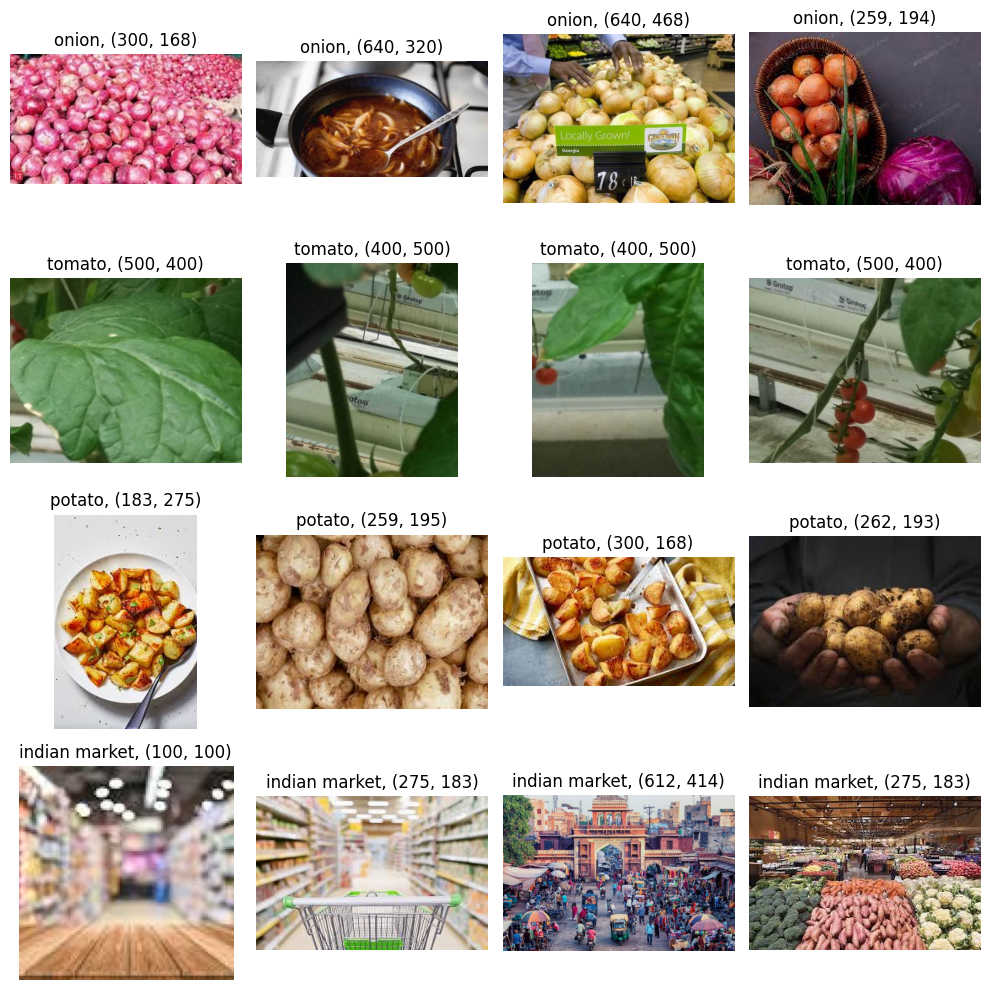

In [ ]:
plt.figure(figsize=(10,10))

for i,(cat,images) in enumerate(image_dict.items()):
    for j,img in enumerate(images):
        plt.subplot(4,4,4*i+j+1)
        plt.imshow(img)
        plt.title(f"{cat}, {img.size}")
        plt.axis('off')
plt.tight_layout()
plt.show()

#### Observations
- The images of tomato are very vague. In some images, tomato is barely visible. So probably the neural network will learn how the leaves look and predict whether it is tomato or not.
- In some of the onion images, the onions looks like potato due to their color. So it might be confusion for the network to distinguish between potato and onion for these kind of images.
- Some of the market images contains vegetables. If these vegetables are either potato, tomato or onion, the network is going to have a hard time distinguishing them.

### Count of images in each category

<Figure size 600x600 with 0 Axes>

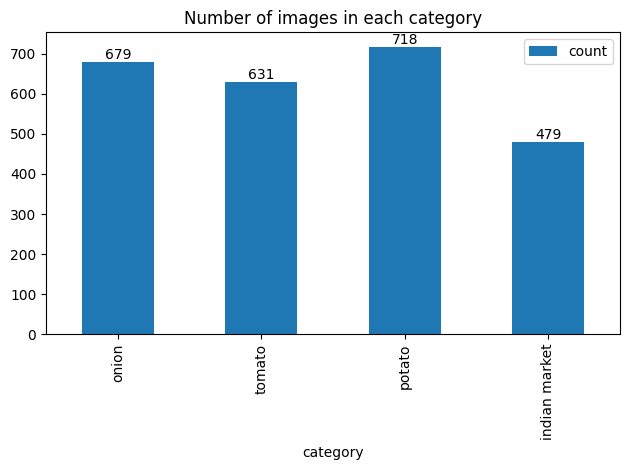

In [ ]:
plt.figure(figsize=(6,6))
ax = pd.DataFrame(
    data = {
        'category':count_dict.keys(),
        'count':count_dict.values()
    }
).plot(kind='bar',x='category',y='count')

ax.bar_label(ax.containers[0])
plt.title('Number of images in each category')
plt.tight_layout()
plt.show()

#### Observations
- The count of images of each class is very close to each other
- The model can perform well without class balancing

### Different sizes of images

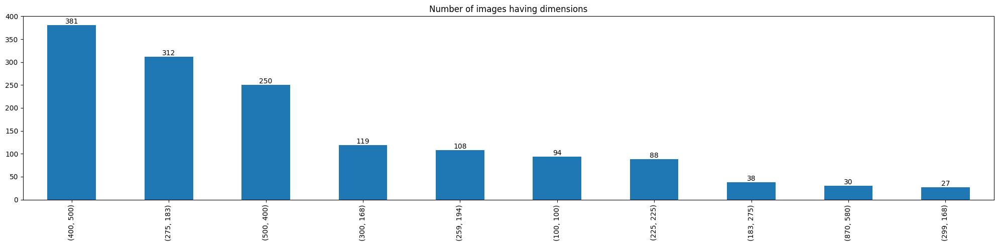

In [ ]:
plt.figure(figsize=(20,5))
ax = pd.Series(size_list).value_counts()[0:10].plot(kind='bar',x='dimension',y='count')
ax.bar_label(ax.containers[0])
plt.title('Number of images having dimensions')
plt.tight_layout()
plt.show()

#### Observations
- There are different sizes of images present in the dataset
- We need to resize each images before feeding it to the model
- This can be achieved in the image generator
- The images which have a very high or very low aspect ratio will be hampered since by resizing so much, the information in them might be corrupted

### Verifying the number of datapoints given in the problem statement

In [ ]:
verification = dict()
for folder in [TRAIN_FOLDER,TEST_FOLDER]:
    verification[folder] = dict()
    for cat in category_names:
        verification[folder][cat] = len(glob.glob(os.path.join(RAW_DATA_PATH,folder,cat)+"/*"))

for folder in verification.keys():
    print(folder)
    for key,value in verification[folder].items():
        print(f"{key}: {value}")
    print()

train
onion: 849
tomato: 789
potato: 898
indian market: 599

test
onion: 83
tomato: 106
potato: 81
indian market: 81



The number of images for each category in the train dataset given is correct<br>
The number of images given in the test dataset is incorrect for onion and potato. They should be interchanged.


# Modelling

#### Utility functions

In [8]:
# a function to plot the loss curve after training
# it also prints the loss and accuracy after training for train and val data to make it easier to infer
def plot_loss(history):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10,2), dpi=150)
    ax = axes.ravel()

    index = np.argmax(history.history['val_accuracy'])

    print(f"Max train accuracy = {history.history['accuracy'][index]}")
    print(f"Max val accuracy = {history.history['val_accuracy'][index]}")
    print(f"Min train loss = {history.history['loss'][index]}")
    print(f"Min val loss = {history.history['val_loss'][index]}")

    # accuracy graph
    ax[0].plot(range(len(history.history['accuracy'])), [acc * 100 for acc in history.history['accuracy']], label='Train', color='b')
    ax[0].plot(range(len(history.history['val_accuracy'])), [acc * 100 for acc in history.history['val_accuracy']], label='Val', color='r')
    ax[0].set_title('Accuracy vs. epoch', fontsize=10)
    ax[0].set_ylabel('Accuracy', fontsize=5)
    ax[0].set_xlabel('epoch', fontsize=5)
    ax[0].legend()

    #loss graph
    ax[1].plot(range(len(history.history['loss'])), history.history['loss'], label='Train', color='b')
    ax[1].plot(range(len(history.history['val_loss'])), history.history['val_loss'], label='Val', color='r')
    ax[1].set_title('Loss vs. epoch', fontsize=7)
    ax[1].set_ylabel('Loss', fontsize=5)
    ax[1].set_xlabel('epoch', fontsize=5)
    ax[1].legend()

    #display the graph
    plt.show()

# this function plots the confusion matrix, precision matrix and recall matrix
def ConfusionMatrix(y_true, y_pred, label_list):

    fig, axes = plt.subplots(1,3,figsize=(20,5),dpi=150)
    ax = axes.ravel()
    cm = metrics.confusion_matrix(y_true,y_pred)

    # plotting confusion matrix
    sns.heatmap(cm, annot=True, xticklabels=label_list, yticklabels=label_list, cmap="YlGnBu", fmt='g',ax=ax[0])
    ax[0].set_title('Confusion matrix')

    # plotting precision matric
    pr = cm / np.sum(cm,axis=0)
    sns.heatmap(pr, annot=True, xticklabels=label_list, yticklabels=label_list, cmap="YlGnBu", fmt='.2f',ax=ax[1])
    ax[1].set_title('Precision matrix')

    # plotting recall matric
    rc = cm / np.sum(cm,axis=1).reshape(-1,1)
    sns.heatmap(rc, annot=True, xticklabels=label_list, yticklabels=label_list, cmap="YlGnBu", fmt='.2f',ax=ax[2])
    ax[2].set_title('Recall matrix')

    plt.tight_layout()
    plt.show()

In [9]:
# image size for the input to the model
WIDTH = 224
HEIGHT = 224

# defining a function to create a generator object for reading dataset
def readData(name, batch_size=32):
    if name == 'train':
        return tf.keras.utils.image_dataset_from_directory(DATA_PATH+'/'+TRAIN_FOLDER, shuffle=True, image_size=(400,400), batch_size=batch_size)
    elif name == 'val':
        return tf.keras.utils.image_dataset_from_directory(DATA_PATH+'/'+VAL_FOLDER, shuffle=False, image_size=(400,400), batch_size=batch_size)
    elif name == 'test':
        return tf.keras.utils.image_dataset_from_directory(DATA_PATH+'/'+TEST_FOLDER, shuffle=False, image_size=(400,400), batch_size=batch_size)
    else:
        print("Please input either one of these: 'train', 'val', 'test'")

In [10]:
# Define the objective function for Optuna
def createObjective(name,getModel):
    def objective(trial):
        # Define the hyperparameters to optimize
        batch_size = trial.suggest_categorical('batch_size', [16, 32])
        dropout_rate = trial.suggest_categorical("dropout_rate", [0.0,0.2,0.4])
        alpha = trial.suggest_float("alpha", 1e-8, 0.1, log=True)
        reg = 'l2'
        is_augmentation = True

        # pick the regularizer
        def pickRegularizer(reg_type,alpha):
            if reg_type == 'l1':
                return tf.keras.regularizers.L1(l1=alpha)
            else:
                return tf.keras.regularizers.L2(l2=alpha)
        regularizer = pickRegularizer(reg,alpha)

        # getting the dataset with selected batch_size and preprocessing it
        train_ds = readData('train',batch_size=batch_size)
        val_ds = readData('val',batch_size=batch_size)
        test_ds = readData('test',batch_size=batch_size)

        # calling the model
        model = getModel(name,dropout_rate,regularizer)

        # compile the model
        model.compile(
            optimizer = 'adam',
            loss = 'sparse_categorical_crossentropy',
            metrics = ['accuracy']
        )

        # defining callbacks
        callbacks = [
            tf.keras.callbacks.EarlyStopping(monitor="val_loss",min_delta=0.0001,patience=10,restore_best_weights=True,start_from_epoch=10),
            tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss",factor=0.1,patience=5,min_delta=0.0001,min_lr=0.000001)
        ]

        # Train the model
        history = model.fit(train_ds, validation_data=val_ds, epochs=25, verbose=0, callbacks=callbacks)

        return min(history.history['val_loss'])
    return objective

# CNN from scratch

We will create a very simple neural network for our use case. Since the number of datapoints is very small, it is very easy for the model to overfit. So we will deploy regularization and dropout in the beginning itseld. On top of that, we will also apply data augmentation in order to increase the number of datapoints, and also to remove multiple variances like positional variance, zoom variance, etc. from the model.

In [ ]:
def getModel(name,dropout_rate,reg):

    model = tf.keras.Sequential(
        name = name,
        layers = [
            tf.keras.layers.Resizing(300, 300),
            tf.keras.layers.RandomCrop(HEIGHT, WIDTH),
            tf.keras.layers.RandomRotation(factor=(-0.1,0.1)),
            tf.keras.layers.Rescaling(1.0/255),
            tf.keras.layers.Conv2D(filters=16,kernel_size=3,padding='same',activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=32,kernel_size=3,padding='same',activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=64,kernel_size=3,padding='same',activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=128,kernel_size=3,padding='same',activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=256,kernel_size=3,padding='same',activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.GlobalAveragePooling2D(),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.Dropout(rate=dropout_rate),
            tf.keras.layers.Dense(units=128,activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.Dropout(rate=dropout_rate),
            tf.keras.layers.Dense(units=4,activation='softmax')
        ]
    )
    return model

In [ ]:
# Define the hyperparameters to optimize
batch_size = 32
dropout_rate = 0.2
alpha = 0.0001
reg = tf.keras.regularizers.L2(l2=alpha)

# getting the dataset with selected batch_size and preprocessing it
train_ds = readData('train',batch_size=batch_size)
val_ds = readData('val',batch_size=batch_size)
test_ds = readData('test',batch_size=batch_size)

# calling the model
model = getModel('custom_cnn',dropout_rate,reg)

# compile the model
model.compile(
    optimizer = 'adam',
    loss = 'sparse_categorical_crossentropy',
    metrics = ['accuracy']
)

# setting up tensorboard
log_dir = "custom_cnn_logs"
!rm -rf log_dir

# defining callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor="val_loss",min_delta=0.0001,patience=10,restore_best_weights=True,start_from_epoch=10),
    tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss",factor=0.1,patience=5,min_delta=0.0001,min_lr=0.000001),
    tf.keras.callbacks.TensorBoard(log_dir=log_dir)
]

# Train the model
history = model.fit(train_ds, validation_data=val_ds, epochs=30, verbose=1, callbacks=callbacks)

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
Epoch 1/30
79/79 [==============================] - 34s 204ms/step - loss: 0.7248 - accuracy: 0.7371 - val_loss: 1.4209 - val_accuracy: 0.3360 - lr: 0.0010
Epoch 2/30
79/79 [==============================] - 21s 257ms/step - loss: 0.6206 - accuracy: 0.7758 - val_loss: 1.2072 - val_accuracy: 0.4395 - lr: 0.0010
Epoch 3/30
79/79 [==============================] - 28s 338ms/step - loss: 0.5529 - accuracy: 0.8034 - val_loss: 1.0145 - val_accuracy: 0.6051 - lr: 0.0010
Epoch 4/30
79/79 [==============================] - 19s 225ms/step - loss: 0.5319 - accuracy: 0.8022 - val_loss: 3.0461 - val_accuracy: 0.2739 - lr: 0.0010
Epoch 5/30
79/79 [==============================] - 24s 298ms/step - loss: 0.5390 - accuracy: 0.8065 - val_loss: 1.0768 - val_accuracy: 0.5987 - lr: 0.0010
Epoch 6/30
79/79 [==============================] - 17s 200ms/step - loss: 0.5147 - accuracy: 0.823

11/11 [==============================] - 2s 161ms/step
Found 351 files belonging to 4 classes.
Max train accuracy = 0.8966892957687378
Max val accuracy = 0.8662420511245728
Min train loss = 0.2943452298641205
Min val loss = 0.3753196597099304


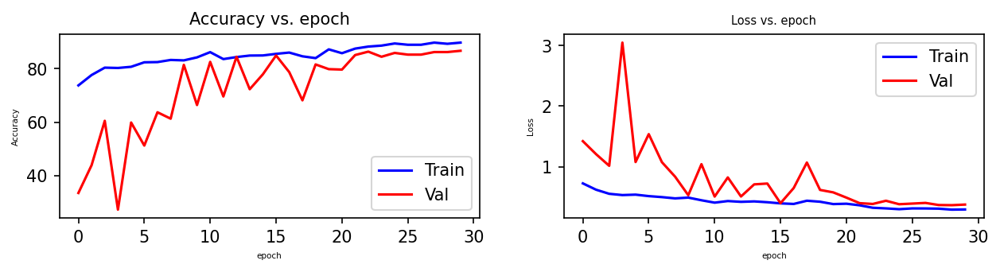

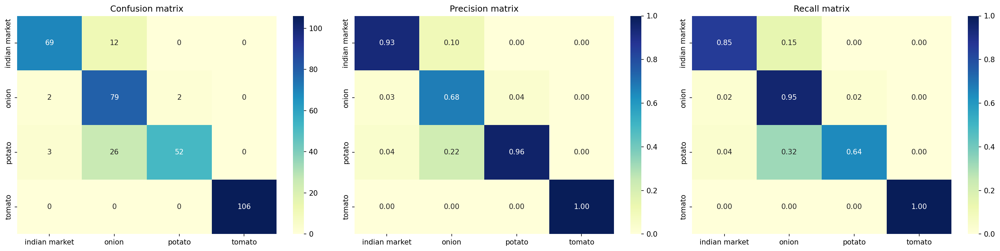

In [ ]:
y_prob = model.predict(test_ds)
y_pred = tf.argmax(y_prob, axis=1)
y_true = tf.concat([y for x, y in test_ds], axis=0)
x_true = tf.concat([x for x, y in test_ds], axis=0)
class_names = readData('test').class_names

plot_loss(history)
ConfusionMatrix(y_true,y_pred,class_names)

# Max train accuracy = 0.9226166605949402
# Max val accuracy = 0.9283439517021179
# Min train loss = 0.2065521776676178
# Min val loss = 0.2142053097486496

In [ ]:
%load_ext tensorboard
%tensorboard --logdir={log_dir}

<IPython.core.display.Javascript object>

#### Observations
- We can see that the methods to reduce overfitting are doing a great job in the first try itself
- The model's performance is very good given that we are training a network from scratch with such a small dataset.
- The model is not overfitting at all.
- Though it might be possible that our model is underfitting, since the accuracy is below 90% and we have used a sime architecture.

# Increasing model complexity to improve the performance

Let's try to increase the model complexity in order to check whether we can extract more performance from the model or not. We will add a few more convolution layers, increase the feature map size.

In [ ]:
def getModel(name,dropout_rate,reg):

    model = tf.keras.Sequential(
        name = name,
        layers = [
            tf.keras.layers.Resizing(300, 300),
            tf.keras.layers.RandomCrop(HEIGHT, WIDTH),
            tf.keras.layers.RandomRotation(factor=(-0.1,0.1)),
            tf.keras.layers.Rescaling(1.0/255),
            tf.keras.layers.Conv2D(filters=16,kernel_size=3,padding='same',activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=32,kernel_size=3,padding='same',activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=64,kernel_size=3,padding='same',activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=128,kernel_size=3,padding='same',activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.Conv2D(filters=128,kernel_size=3,padding='same',activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=256,kernel_size=3,padding='same',activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.Conv2D(filters=256,kernel_size=3,padding='same',activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.MaxPooling2D(),
            tf.keras.layers.Conv2D(filters=512,kernel_size=3,padding='same',activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.Conv2D(filters=512,kernel_size=3,padding='same',activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.GlobalAveragePooling2D(),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.Dropout(rate=dropout_rate),
            tf.keras.layers.Dense(units=256,activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.Dropout(rate=dropout_rate),
            tf.keras.layers.Dense(units=4,activation='softmax')
        ]
    )
    return model

In [ ]:
# Define the hyperparameters to optimize
batch_size = 32
dropout_rate = 0.2
alpha = 0.0001
reg = tf.keras.regularizers.L2(l2=alpha)

# getting the dataset with selected batch_size and preprocessing it
train_ds = readData('train',batch_size=batch_size)
val_ds = readData('val',batch_size=batch_size)
test_ds = readData('test',batch_size=batch_size)

# calling the model
model = getModel('custom_cnn',dropout_rate,reg)

# compile the model
model.compile(
    optimizer = 'adam',
    loss = 'sparse_categorical_crossentropy',
    metrics = ['accuracy']
)

# setting up tensorboard
log_dir = "custom_cnn_logs"
!rm -rf log_dir

# defining callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor="val_loss",min_delta=0.0001,patience=10,restore_best_weights=True,start_from_epoch=10),
    tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss",factor=0.1,patience=5,min_delta=0.0001,min_lr=0.000001),
    tf.keras.callbacks.TensorBoard(log_dir=log_dir)
]

# Train the model
history = model.fit(train_ds, validation_data=val_ds, epochs=30, verbose=1, callbacks=callbacks)

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
Epoch 1/30
79/79 [==============================] - 23s 210ms/step - loss: 1.0372 - accuracy: 0.6155 - val_loss: 13.6579 - val_accuracy: 0.2707 - lr: 0.0010
Epoch 2/30
79/79 [==============================] - 19s 218ms/step - loss: 0.7689 - accuracy: 0.7224 - val_loss: 13.6631 - val_accuracy: 0.2707 - lr: 0.0010
Epoch 3/30
79/79 [==============================] - 16s 196ms/step - loss: 0.6772 - accuracy: 0.7655 - val_loss: 12.0614 - val_accuracy: 0.1959 - lr: 0.0010
Epoch 4/30
79/79 [==============================] - 17s 201ms/step - loss: 0.6621 - accuracy: 0.7786 - val_loss: 7.0726 - val_accuracy: 0.3997 - lr: 0.0010
Epoch 5/30
79/79 [==============================] - 21s 258ms/step - loss: 0.6284 - accuracy: 0.7726 - val_loss: 1.2696 - val_accuracy: 0.5207 - lr: 0.0010
Epoch 6/30
79/79 [==============================] - 19s 224ms/step - loss: 0.6276 - accuracy: 0.

11/11 [==============================] - 2s 152ms/step
Found 351 files belonging to 4 classes.
Max train accuracy = 0.849621057510376
Max val accuracy = 0.837579607963562
Min train loss = 0.4006928503513336
Min val loss = 0.4312150180339813


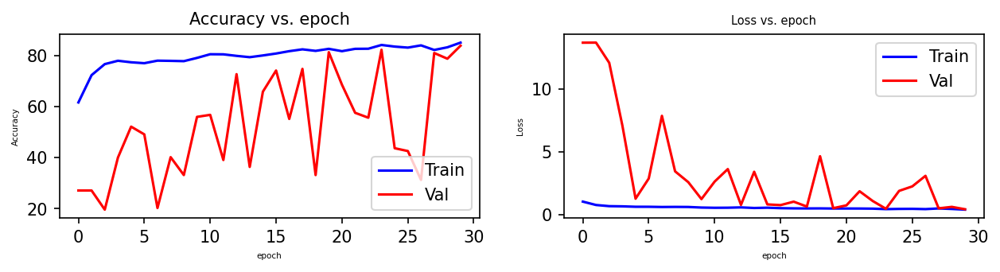

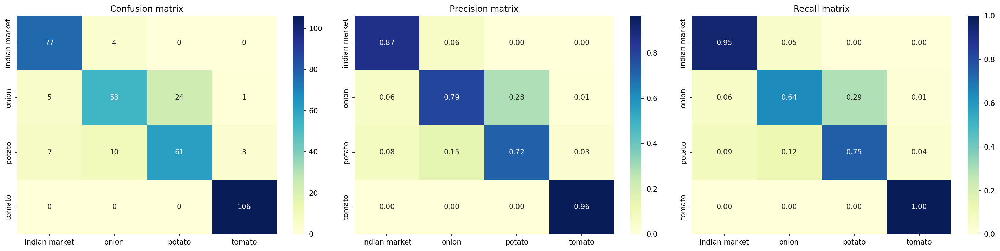

In [ ]:
y_prob = model.predict(test_ds)
y_pred = tf.argmax(y_prob, axis=1)
y_true = tf.concat([y for x, y in test_ds], axis=0)
x_true = tf.concat([x for x, y in test_ds], axis=0)
class_names = readData('test').class_names

plot_loss(history)
ConfusionMatrix(y_true,y_pred,class_names)

# Max train accuracy = 0.9226166605949402
# Max val accuracy = 0.9283439517021179
# Min train loss = 0.2065521776676178
# Min val loss = 0.2142053097486496

In [ ]:
%load_ext tensorboard
%tensorboard --logdir={log_dir}

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 6213), started 0:13:08 ago. (Use '!kill 6213' to kill it.)

<IPython.core.display.Javascript object>

#### Observations
- There is a huge fluctuation in the validation accuracy and loss
- This might be happening becuase of the distribution of training and val data might be different
- The overall performance of the model is worse than that of the simpler model.

## Pretrained VGG16

Now let's try some of the pre-trained models, which are trained on image net dataset. We will remove the top layers (classification laters) and add our own layers to train the classification.

### Defining the model

In [ ]:
# downloading the model
pretrained_vgg16 = tf.keras.applications.VGG16(include_top=False,weights='imagenet',input_shape=(HEIGHT,WIDTH,3),pooling='avg')

# setting trainable = False
pretrained_vgg16.trainable = False

def getModel(name,dropout_rate,reg):
    seq = tf.keras.Sequential(
        name = name,
        layers = [
            tf.keras.layers.Resizing(300, 300),
            tf.keras.layers.RandomCrop(HEIGHT, WIDTH),
            tf.keras.layers.RandomRotation(factor=(-0.1,0.1)),
            tf.keras.layers.Rescaling(1.0/255),
            pretrained_vgg16,
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.Dropout(rate=dropout_rate),
            tf.keras.layers.Dense(256,activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.Dropout(rate=dropout_rate),
            tf.keras.layers.Dense(4,activation='softmax',kernel_regularizer=reg,bias_regularizer=reg)
        ]
    )

    return seq

58889256/58889256 [==============================] - 0s 0us/step


### Searching for the best hyperparameter

In [ ]:
# creating the objective function given the model
obj = createObjective('pretrained_VGG16',getModel)

# Create a study and optimize the objective function
study = optuna.create_study(direction='minimize')
study.optimize(obj, n_trials=5, show_progress_bar=True)

# # Get the best hyperparameters
best_params = study.best_params
print("Best hyperparameters:", best_params)

[I 2023-11-25 17:32:05,190] A new study created in memory with name: no-name-9a192d70-2df1-4f92-8216-027fb8de81d2


  0%|          | 0/5 [00:00<?, ?it/s]

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-25 17:39:52,898] Trial 0 finished with value: 0.1957613080739975 and parameters: {'batch_size': 32, 'dropout_rate': 0.2, 'alpha': 2.1283116433800812e-07}. Best is trial 0 with value: 0.1957613080739975.
Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-25 17:46:49,378] Trial 1 finished with value: 0.41897183656692505 and parameters: {'batch_size': 16, 'dropout_rate': 0.0, 'alpha': 0.029922618237130903}. Best is trial 0 with value: 0.1957613080739975.
Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-25 17:53:56,292] Trial 2 finished with value: 0.2338872104883194 and parameters: {'batch_size': 32, 'dropout_rate': 0.4, 'alpha': 6.659239601542189e-05}. Best is trial 0 with value: 0.195761308073997

In [ ]:
study.optimize(obj, n_trials=5, show_progress_bar=True)

  0%|          | 0/5 [00:00<?, ?it/s]

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-25 18:15:04,858] Trial 5 finished with value: 0.41390398144721985 and parameters: {'batch_size': 32, 'dropout_rate': 0.4, 'alpha': 0.01075654492337728}. Best is trial 4 with value: 0.19540159404277802.
Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-25 18:22:14,378] Trial 6 finished with value: 0.3762601315975189 and parameters: {'batch_size': 32, 'dropout_rate': 0.4, 'alpha': 0.0026051024053338366}. Best is trial 4 with value: 0.19540159404277802.
Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-25 18:28:56,182] Trial 7 finished with value: 0.5302455425262451 and parameters: {'batch_size': 16, 'dropout_rate': 0.2, 'alpha': 0.061164048081515786}. Best is trial 4 with value: 0.1954015940427780

<ipython-input-14-4f25878d1741>:2: ExperimentalWarning: plot_param_importances is experimental (supported from v2.2.0). The interface can change in the future.
  plot_param_importances(study)


<Axes: title={'left': 'Hyperparameter Importances'}, xlabel='Hyperparameter Importance', ylabel='Hyperparameter'>

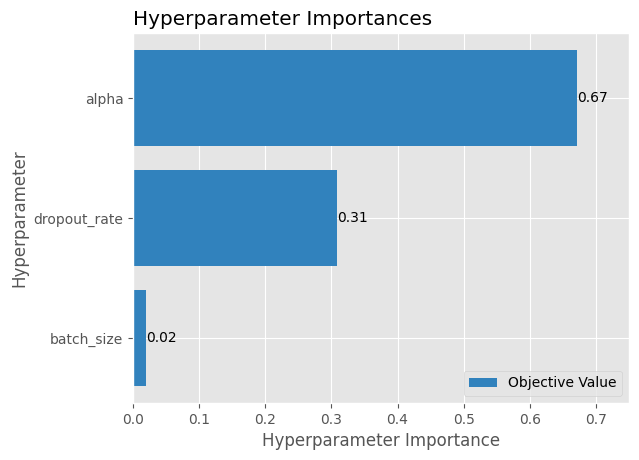

In [ ]:
# plotting hyperparameter importances
plot_param_importances(study)

#### Observations
- As we can see, the regularization rate is the most important hyperparameter
- batch size does not have much effect on the performance, so from now on we will use a batch size of 32.
- dropout rate also does not have a lot of effect on the model performance compared to regularization. So we will use a constant dropout rate of 0.0

In [ ]:
# # Get the best hyperparameters
best_params = study.best_params
print("Best hyperparameters:", best_params)

Best hyperparameters: {'batch_size': 32, 'dropout_rate': 0.4, 'alpha': 2.30419806532844e-07}


### Training the model with best hyperparameters

In [ ]:
# Define the hyperparameters to optimize
batch_size = 32
dropout_rate = 0.4
alpha = 2.30e-07
reg = tf.keras.regularizers.L2(l2=alpha)

# getting the dataset with selected batch_size and preprocessing it
train_ds = readData('train',batch_size=batch_size)
val_ds = readData('val',batch_size=batch_size)
test_ds = readData('test',batch_size=batch_size)

# calling the model
model = getModel('pretrainedVGG16',dropout_rate,reg)

# compile the model
model.compile(
    optimizer = 'adam',
    loss = 'sparse_categorical_crossentropy',
    metrics = ['accuracy']
)

# defining callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor="val_loss",min_delta=0.0001,patience=10,restore_best_weights=True,start_from_epoch=10),
    tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss",factor=0.1,patience=5,min_delta=0.0001,min_lr=0.000001)
]

# Train the model
history = model.fit(train_ds, validation_data=val_ds, epochs=30, verbose=1, callbacks=callbacks)

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
Epoch 1/30
79/79 [==============================] - 24s 234ms/step - loss: 0.7095 - accuracy: 0.7327 - val_loss: 0.8078 - val_accuracy: 0.7882 - lr: 0.0010
Epoch 2/30
79/79 [==============================] - 20s 244ms/step - loss: 0.4476 - accuracy: 0.8333 - val_loss: 0.5693 - val_accuracy: 0.8965 - lr: 0.0010
Epoch 3/30
79/79 [==============================] - 21s 227ms/step - loss: 0.3989 - accuracy: 0.8588 - val_loss: 0.3987 - val_accuracy: 0.8965 - lr: 0.0010
Epoch 4/30
79/79 [==============================] - 18s 221ms/step - loss: 0.3815 - accuracy: 0.8568 - val_loss: 0.3133 - val_accuracy: 0.8965 - lr: 0.0010
Epoch 5/30
79/79 [==============================] - 18s 214ms/step - loss: 0.3559 - accuracy: 0.8684 - val_loss: 0.2632 - val_accuracy: 0.9013 - lr: 0.0010
Epoch 6/30
79/79 [==============================] - 19s 224ms/step - loss: 0.3471 - accuracy: 0.864

### Checking model performance

11/11 [==============================] - 6s 507ms/step
Found 351 files belonging to 4 classes.
Max train accuracy = 0.9226166605949402
Max val accuracy = 0.9283439517021179
Min train loss = 0.2065521776676178
Min val loss = 0.2142053097486496


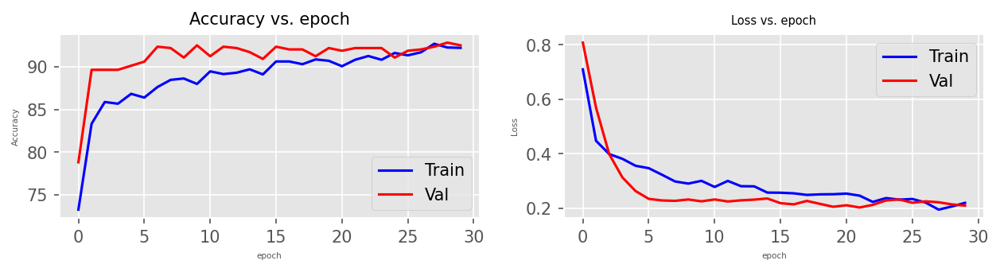

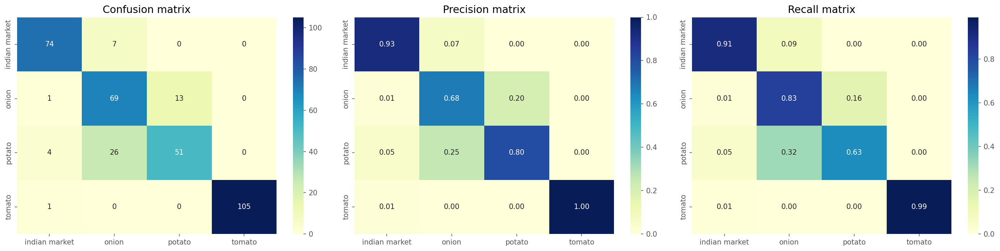

In [ ]:
y_prob = model.predict(test_ds)
y_pred = tf.argmax(y_prob, axis=1)
y_true = tf.concat([y for x, y in test_ds], axis=0)
x_true = tf.concat([x for x, y in test_ds], axis=0)
class_names = readData('test').class_names

plot_loss(history)
ConfusionMatrix(y_true,y_pred,class_names)

#### Observations
- Pre-trained VGG16 is able to out perform our custom model

## Redefining the objective function for hyperparmeter tuning

In [ ]:
# Define the objective function for Optuna
def createObjective(name,getModel):
    def objective(trial):
        # Define the hyperparameters to optimize
        batch_size = 32
        dropout_rate = 0.4
        alpha = trial.suggest_float("alpha", 1e-8, 0.1, log=True)
        reg = 'l2'

        # pick the regularizer
        def pickRegularizer(reg_type,alpha):
            if reg_type == 'l1':
                return tf.keras.regularizers.L1(l1=alpha)
            else:
                return tf.keras.regularizers.L2(l2=alpha)
        regularizer = pickRegularizer(reg,alpha)

        # getting the dataset with selected batch_size and preprocessing it
        train_ds = readData('train',batch_size=batch_size)
        val_ds = readData('val',batch_size=batch_size)
        test_ds = readData('test',batch_size=batch_size)

        # calling the model
        model = getModel(name,dropout_rate,regularizer)

        # compile the model
        model.compile(
            optimizer = 'adam',
            loss = 'sparse_categorical_crossentropy',
            metrics = ['accuracy']
        )

        # defining callbacks
        callbacks = [
            tf.keras.callbacks.EarlyStopping(monitor="val_loss",min_delta=0.0001,patience=10,restore_best_weights=True,start_from_epoch=10),
            tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss",factor=0.1,patience=5,min_delta=0.0001,min_lr=0.000001)
        ]

        # Train the model
        history = model.fit(train_ds, validation_data=val_ds, epochs=20, verbose=0) #, callbacks=callbacks

        return min(history.history['val_loss'])
    return objective

## Pretrained ResNet50

### Defining the model

In [ ]:
# downloading the model
pretrained_resnet = tf.keras.applications.resnet50.ResNet50(include_top=False,weights='imagenet',input_shape=(HEIGHT,WIDTH,3),pooling='avg')

# setting trainable = False
pretrained_resnet.trainable = False

def getModel(name,dropout_rate,reg):
    seq = tf.keras.Sequential(
        name = name,
        layers = [
            tf.keras.layers.Resizing(300, 300),
            tf.keras.layers.RandomCrop(HEIGHT, WIDTH),
            tf.keras.layers.RandomRotation(factor=(-0.1,0.1)),
            tf.keras.layers.Rescaling(1.0/255),
            pretrained_resnet,
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.Dropout(rate=dropout_rate),
            tf.keras.layers.Dense(256,activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.Dropout(rate=dropout_rate),
            tf.keras.layers.Dense(4,activation='softmax',kernel_regularizer=reg,bias_regularizer=reg)
        ]
    )

    return seq

94765736/94765736 [==============================] - 5s 0us/step


### Searching for the best hyperparameter

In [ ]:
# creating the objective function given the model
obj = createObjective('pretrained_Resnet',getModel)

# Create a study and optimize the objective function
study = optuna.create_study(direction='minimize')
study.optimize(obj, n_trials=5, show_progress_bar=True)

# # Get the best hyperparameters
best_params = study.best_params
print("Best hyperparameters:", best_params)

[I 2023-11-25 18:53:13,775] A new study created in memory with name: no-name-03046de0-9ed5-430e-a659-a37e990a8c1f


  0%|          | 0/5 [00:00<?, ?it/s]

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-25 18:58:48,257] Trial 0 finished with value: 0.781572699546814 and parameters: {'alpha': 0.0004203794816717774}. Best is trial 0 with value: 0.781572699546814.
Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-25 19:04:21,328] Trial 1 finished with value: 0.8749873638153076 and parameters: {'alpha': 0.001902282679526098}. Best is trial 0 with value: 0.781572699546814.
Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-25 19:10:00,195] Trial 2 finished with value: 0.7300605773925781 and parameters: {'alpha': 3.836304789880116e-05}. Best is trial 2 with value: 0.7300605773925781.
Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes

In [ ]:
study.optimize(obj, n_trials=5, show_progress_bar=True)

# # Get the best hyperparameters
best_params = study.best_params
print("Best hyperparameters:", best_params)

  0%|          | 0/5 [00:00<?, ?it/s]

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-25 19:26:34,743] Trial 5 finished with value: 0.7138864398002625 and parameters: {'alpha': 1.0795200776464035e-05}. Best is trial 5 with value: 0.7138864398002625.
Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-25 19:31:50,706] Trial 6 finished with value: 0.7138316035270691 and parameters: {'alpha': 4.618209148211667e-06}. Best is trial 6 with value: 0.7138316035270691.
Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-25 19:37:13,732] Trial 7 finished with value: 0.7025340795516968 and parameters: {'alpha': 8.657613951058189e-08}. Best is trial 7 with value: 0.7025340795516968.
Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 cl

### Training the model with best hyperparameters

In [ ]:
# Define the hyperparameters to optimize
batch_size = 32
dropout_rate = 0.4
alpha = 3.59e-08
reg = tf.keras.regularizers.L2(l2=alpha)

# getting the dataset with selected batch_size and preprocessing it
train_ds = readData('train',batch_size=batch_size)
val_ds = readData('val',batch_size=batch_size)
test_ds = readData('test',batch_size=batch_size)

# calling the model
model = getModel('pretrained_Resnet',dropout_rate,reg)

# compile the model
model.compile(
    optimizer = 'adam',
    loss = 'sparse_categorical_crossentropy',
    metrics = ['accuracy']
)

# defining callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor="val_loss",min_delta=0.0001,patience=10,restore_best_weights=True,start_from_epoch=10),
    tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss",factor=0.1,patience=5,min_delta=0.0001,min_lr=0.000001)
]

# Train the model
history = model.fit(train_ds, validation_data=val_ds, epochs=30, verbose=1, callbacks=callbacks)

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
Epoch 1/30
79/79 [==============================] - 62s 307ms/step - loss: 1.2100 - accuracy: 0.4882 - val_loss: 1.3559 - val_accuracy: 0.3169 - lr: 0.0010
Epoch 2/30
79/79 [==============================] - 26s 322ms/step - loss: 1.0387 - accuracy: 0.5568 - val_loss: 1.1844 - val_accuracy: 0.4475 - lr: 0.0010
Epoch 3/30
79/79 [==============================] - 19s 235ms/step - loss: 0.9599 - accuracy: 0.5931 - val_loss: 1.0972 - val_accuracy: 0.5143 - lr: 0.0010
Epoch 4/30
79/79 [==============================] - 19s 233ms/step - loss: 0.9413 - accuracy: 0.6003 - val_loss: 1.0642 - val_accuracy: 0.5844 - lr: 0.0010
Epoch 5/30
79/79 [==============================] - 17s 199ms/step - loss: 0.8954 - accuracy: 0.6203 - val_loss: 0.9903 - val_accuracy: 0.5844 - lr: 0.0010
Epoch 6/30
79/79 [==============================] - 17s 203ms/step - loss: 0.8854 - accuracy: 0.631

### Checking model performance

11/11 [==============================] - 4s 276ms/step
Found 351 files belonging to 4 classes.
Max train accuracy = 0.6745113730430603
Max val accuracy = 0.7356687784194946
Min train loss = 0.7890511751174927
Min val loss = 0.6810575127601624


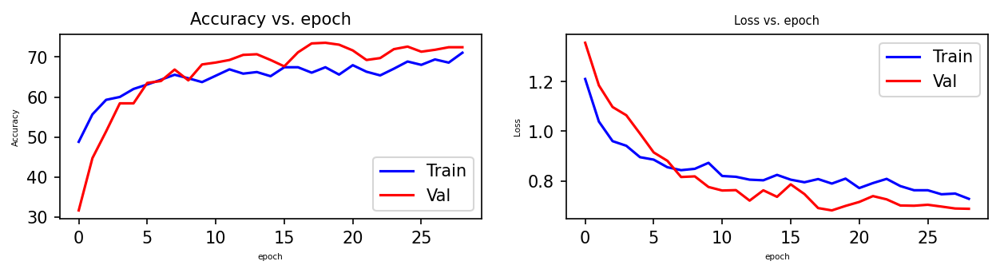

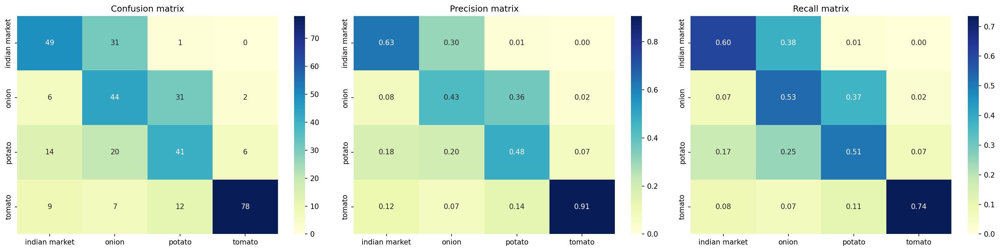

In [ ]:
y_prob = model.predict(test_ds)
y_pred = tf.argmax(y_prob, axis=1)
y_true = tf.concat([y for x, y in test_ds], axis=0)
x_true = tf.concat([x for x, y in test_ds], axis=0)
class_names = readData('test').class_names

plot_loss(history)
ConfusionMatrix(y_true,y_pred,class_names)

#### Observations
- The pre-trained res net model is not able to beat even our custom model

## Pretrained MobileNetV3Small

### Defining the model

In [ ]:
# downloading the model
pretrained_mobilenet = tf.keras.applications.MobileNetV3Small(input_shape=(HEIGHT,WIDTH,3),include_top=False,weights='imagenet',pooling='avg',)

# setting trainable = False
pretrained_mobilenet.trainable = False

def getModel(name,dropout_rate,reg):
    seq = tf.keras.Sequential(
        name = name,
        layers = [
            tf.keras.layers.Resizing(300, 300),
            tf.keras.layers.RandomCrop(HEIGHT, WIDTH),
            tf.keras.layers.RandomRotation(factor=(-0.1,0.1)),
            tf.keras.layers.Rescaling(1.0/127.5, offset=-1),
            pretrained_mobilenet,
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.Dropout(rate=dropout_rate),
            tf.keras.layers.Dense(256,activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.Dropout(rate=dropout_rate),
            tf.keras.layers.Dense(4,activation='softmax',kernel_regularizer=reg,bias_regularizer=reg)
        ]
    )

    return seq

4334752/4334752 [==============================] - 0s 0us/step


### Searching for the best hyperparameter

In [ ]:
# creating the objective function given the model
obj = createObjective('pretrained_mobilenet',getModel)

# Create a study and optimize the objective function
study = optuna.create_study(direction='minimize')
study.optimize(obj, n_trials=5, show_progress_bar=True)

# # Get the best hyperparameters
best_params = study.best_params
print("Best hyperparameters:", best_params)

[I 2023-11-26 18:09:58,706] A new study created in memory with name: no-name-8625fc0c-30ee-460a-9b43-336f1f7b16d3


  0%|          | 0/5 [00:00<?, ?it/s]

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-26 18:15:03,679] Trial 0 finished with value: 0.5672311186790466 and parameters: {'alpha': 3.940718311712661e-07}. Best is trial 0 with value: 0.5672311186790466.
Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-26 18:19:50,404] Trial 1 finished with value: 0.6737157702445984 and parameters: {'alpha': 0.000315962759430424}. Best is trial 0 with value: 0.5672311186790466.
Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-26 18:24:52,465] Trial 2 finished with value: 0.5915345549583435 and parameters: {'alpha': 8.469555934330742e-08}. Best is trial 0 with value: 0.5672311186790466.
Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 clas

In [ ]:
study.optimize(obj, n_trials=5, show_progress_bar=True)

# # Get the best hyperparameters
best_params = study.best_params
print("Best hyperparameters:", best_params)

  0%|          | 0/5 [00:00<?, ?it/s]

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-26 18:39:58,092] Trial 5 finished with value: 0.8080242872238159 and parameters: {'alpha': 0.010217552605706478}. Best is trial 4 with value: 0.5589413046836853.
Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-26 18:44:44,130] Trial 6 finished with value: 0.5599690675735474 and parameters: {'alpha': 8.647549026998659e-08}. Best is trial 4 with value: 0.5589413046836853.
Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
[I 2023-11-26 18:49:29,361] Trial 7 finished with value: 0.7064862847328186 and parameters: {'alpha': 0.0007957720253456414}. Best is trial 4 with value: 0.5589413046836853.
Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 clas

### Training the model with best hyperparameters

In [ ]:
# Define the hyperparameters to optimize
batch_size = 16
dropout_rate = 0.4
alpha = 1.12e-05
reg = tf.keras.regularizers.L2(l2=alpha)

# getting the dataset with selected batch_size and preprocessing it
train_ds = readData('train',batch_size=batch_size)
val_ds = readData('val',batch_size=batch_size)
test_ds = readData('test',batch_size=batch_size)

# calling the model
model = getModel('pretrained_mobilenet',dropout_rate,reg)

# compile the model
model.compile(
    optimizer = 'adam',
    loss = 'sparse_categorical_crossentropy',
    metrics = ['accuracy']
)

# defining callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor="val_loss",min_delta=0.0001,patience=10,restore_best_weights=True,start_from_epoch=10),
    tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss",factor=0.1,patience=5,min_delta=0.0001,min_lr=0.000001)
]

# Train the model
history = model.fit(train_ds, validation_data=val_ds, epochs=30, verbose=1, callbacks=callbacks)

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
Epoch 1/30
157/157 [==============================] - 30s 100ms/step - loss: 1.0875 - accuracy: 0.5437 - val_loss: 1.2909 - val_accuracy: 0.2261 - lr: 0.0010
Epoch 2/30
157/157 [==============================] - 15s 94ms/step - loss: 0.9602 - accuracy: 0.5931 - val_loss: 1.0473 - val_accuracy: 0.6178 - lr: 0.0010
Epoch 3/30
157/157 [==============================] - 15s 94ms/step - loss: 0.8961 - accuracy: 0.6274 - val_loss: 0.8363 - val_accuracy: 0.7086 - lr: 0.0010
Epoch 4/30
157/157 [==============================] - 15s 94ms/step - loss: 0.8859 - accuracy: 0.6227 - val_loss: 0.7063 - val_accuracy: 0.7309 - lr: 0.0010
Epoch 5/30
157/157 [==============================] - 14s 88ms/step - loss: 0.8570 - accuracy: 0.6374 - val_loss: 0.6485 - val_accuracy: 0.7277 - lr: 0.0010
Epoch 6/30
157/157 [==============================] - 15s 96ms/step - loss: 0.8637 - accuracy

### Checking model performance

22/22 [==============================] - 3s 87ms/step
Found 351 files belonging to 4 classes.
Max train accuracy = 0.6828879117965698
Max val accuracy = 0.7834395170211792
Min train loss = 0.7465966939926147
Min val loss = 0.5979008078575134


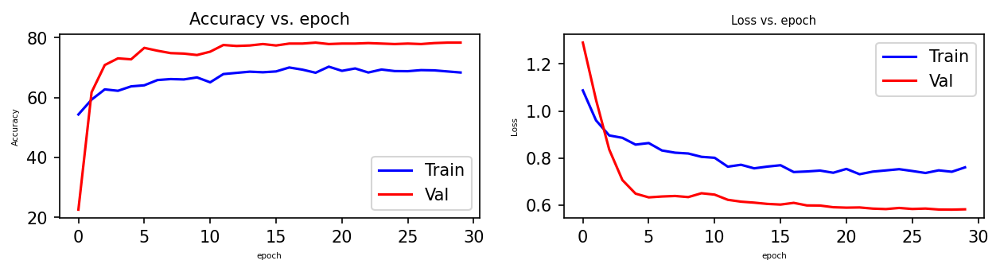

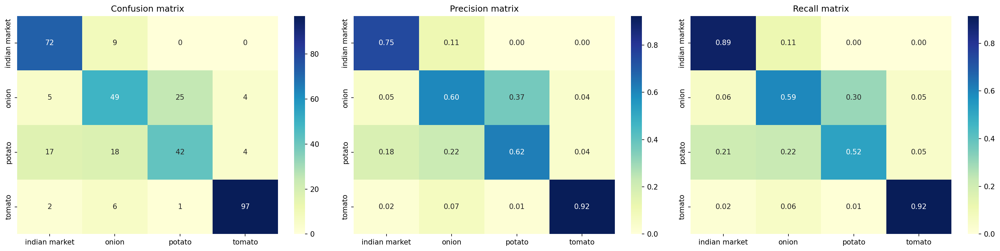

In [ ]:
y_prob = model.predict(test_ds)
y_pred = tf.argmax(y_prob, axis=1)
y_true = tf.concat([y for x, y in test_ds], axis=0)
x_true = tf.concat([x for x, y in test_ds], axis=0)
class_names = readData('test').class_names

plot_loss(history)
ConfusionMatrix(y_true,y_pred,class_names)

#### Observations
- Pre-trained mobile is not able to beat our custom model

### Out of all the models, we can see that the pretrained VGG16 model performs the best out of all. So we will pick the VGG16 model, train it with the layers frozen, and post that we will try to fine tune the model by unfreezing the layers, in order to extract more performance for our use case

# Pretrained VGG16 (best performer)

### Defining the model

In [11]:
# downloading the model
pretrained_vgg16 = tf.keras.applications.VGG16(include_top=False,weights='imagenet',input_shape=(HEIGHT,WIDTH,3),pooling='avg')

# setting trainable = False
pretrained_vgg16.trainable = False

def getModel(name,dropout_rate,reg):
    seq = tf.keras.Sequential(
        name = name,
        layers = [
            tf.keras.layers.Resizing(300, 300),
            tf.keras.layers.RandomCrop(HEIGHT, WIDTH),
            tf.keras.layers.RandomRotation(factor=(-0.1,0.1)),
            tf.keras.layers.Rescaling(1.0/255),
            pretrained_vgg16,
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.Dropout(rate=dropout_rate),
            tf.keras.layers.Dense(256,activation='relu',kernel_regularizer=reg,bias_regularizer=reg),
            tf.keras.layers.Dropout(rate=dropout_rate),
            tf.keras.layers.Dense(4,activation='softmax',kernel_regularizer=reg,bias_regularizer=reg)
        ]
    )

    return seq

58889256/58889256 [==============================] - 0s 0us/step


### Searching for the best hyperparameter

### Training the model with best hyperparameters

In [12]:
# Define the hyperparameters to optimize
batch_size = 32
dropout_rate = 0.4
alpha = 2.30e-07
reg = tf.keras.regularizers.L2(l2=alpha)

# getting the dataset with selected batch_size and preprocessing it
train_ds = readData('train',batch_size=batch_size)
val_ds = readData('val',batch_size=batch_size)
test_ds = readData('test',batch_size=batch_size)

# calling the model
model = getModel('pretrainedVGG16',dropout_rate,reg)

# compile the model
model.compile(
    optimizer = 'adam',
    loss = 'sparse_categorical_crossentropy',
    metrics = ['accuracy']
)

# defining callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor="val_loss",min_delta=0.0001,patience=10,restore_best_weights=True,start_from_epoch=10),
    tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss",factor=0.1,patience=5,min_delta=0.0001,min_lr=0.000001)
]

# Train the model
history = model.fit(train_ds, validation_data=val_ds, epochs=30, verbose=1, callbacks=callbacks)

Found 2507 files belonging to 4 classes.
Found 628 files belonging to 4 classes.
Found 351 files belonging to 4 classes.
Epoch 1/30
79/79 [==============================] - 52s 337ms/step - loss: 0.7060 - accuracy: 0.7423 - val_loss: 0.8665 - val_accuracy: 0.7245 - lr: 0.0010
Epoch 2/30
79/79 [==============================] - 17s 204ms/step - loss: 0.4556 - accuracy: 0.8313 - val_loss: 0.6089 - val_accuracy: 0.8360 - lr: 0.0010
Epoch 3/30
79/79 [==============================] - 17s 204ms/step - loss: 0.3749 - accuracy: 0.8580 - val_loss: 0.4139 - val_accuracy: 0.8806 - lr: 0.0010
Epoch 4/30
79/79 [==============================] - 18s 219ms/step - loss: 0.3752 - accuracy: 0.8576 - val_loss: 0.3467 - val_accuracy: 0.8806 - lr: 0.0010
Epoch 5/30
79/79 [==============================] - 21s 255ms/step - loss: 0.3259 - accuracy: 0.8787 - val_loss: 0.2948 - val_accuracy: 0.8997 - lr: 0.0010
Epoch 6/30
79/79 [==============================] - 28s 329ms/step - loss: 0.3382 - accuracy: 0.879

### Fine tuning the model with a very small learning rate and 10 epochs

In [14]:
model.trainable = True

# compile the model after setting trainable = True

opt = tf.keras.optimizers.Adam(learning_rate=1e-5,)
model.compile(
    optimizer = opt,
    loss = 'sparse_categorical_crossentropy',
    metrics = ['accuracy']
)

# defining callbacks
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor="val_loss",min_delta=0.0001,patience=10,restore_best_weights=True,start_from_epoch=10),
    tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss",factor=0.1,patience=5,min_delta=0.0001,min_lr=0.000001)
]

# Train the model
history = model.fit(train_ds, validation_data=val_ds, epochs=10, verbose=1, callbacks=callbacks)

Epoch 1/10
79/79 [==============================] - 54s 502ms/step - loss: 0.1963 - accuracy: 0.9230 - val_loss: 0.2513 - val_accuracy: 0.9315 - lr: 1.0000e-05
Epoch 2/10
79/79 [==============================] - 39s 481ms/step - loss: 0.1392 - accuracy: 0.9501 - val_loss: 0.2556 - val_accuracy: 0.9220 - lr: 1.0000e-05
Epoch 3/10
79/79 [==============================] - 41s 504ms/step - loss: 0.1312 - accuracy: 0.9533 - val_loss: 0.2615 - val_accuracy: 0.9252 - lr: 1.0000e-05
Epoch 4/10
79/79 [==============================] - 40s 493ms/step - loss: 0.0948 - accuracy: 0.9665 - val_loss: 0.2165 - val_accuracy: 0.9443 - lr: 1.0000e-05
Epoch 5/10
79/79 [==============================] - 40s 498ms/step - loss: 0.1032 - accuracy: 0.9657 - val_loss: 0.1563 - val_accuracy: 0.9522 - lr: 1.0000e-05
Epoch 6/10
79/79 [==============================] - 42s 508ms/step - loss: 0.0846 - accuracy: 0.9709 - val_loss: 0.2990 - val_accuracy: 0.9331 - lr: 1.0000e-05
Epoch 7/10
79/79 [======================

### Checking model performance

11/11 [==============================] - 6s 514ms/step
Found 351 files belonging to 4 classes.
Max train accuracy = 0.9812524914741516
Max val accuracy = 0.9585987329483032
Min train loss = 0.05207398533821106
Min val loss = 0.17184984683990479


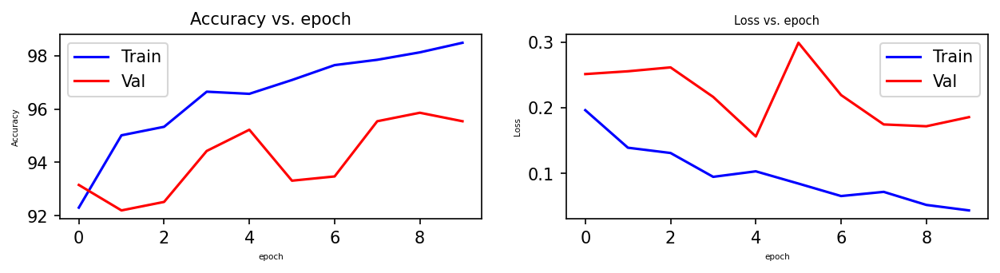

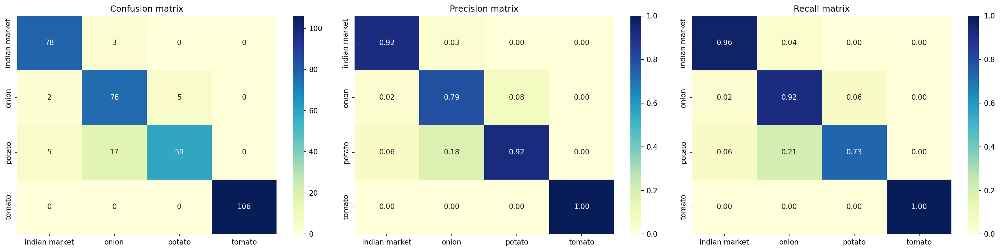

In [15]:
y_prob = model.predict(test_ds)
y_pred = tf.argmax(y_prob, axis=1)
y_true = tf.concat([y for x, y in test_ds], axis=0)
x_true = tf.concat([x for x, y in test_ds], axis=0)
class_names = readData('test').class_names

plot_loss(history)
ConfusionMatrix(y_true,y_pred,class_names)

#### Observations
- The model quickly started to overfit after the first epoch
- This is the reason why we have to be very careful when fine tuning the complete model
- We have restored the best weight of the model where the validation loss is minimum
- We are able to bosst the performance of the model by fine tuning it

# Testing on the test set

In [19]:
y_prob = model.predict(test_ds)
y_pred = tf.argmax(y_prob, axis=1)
y_true = tf.concat([y for x, y in test_ds], axis=0)
x_true = tf.concat([x for x, y in test_ds], axis=0)
class_names = readData('test').class_names

print(f"Test accuracy: {metrics.accuracy_score(y_true,y_pred)*100:.4f}%")

11/11 [==============================] - 2s 204ms/step
Found 351 files belonging to 4 classes.
Test accuracy: 90.8832%


# Conclusion

- We created the train and validation split since the dataset did not have a separate folder for validation images
- We observed that some of the onion images were similar to potato, which might confuse the model between the two classes
- Also, some of the market images contains vegetables. If the vegetables are either potato, tomato or onion, the model might confuse between the classes
- We trained a CNN from scratch, with proper regularization, dropout and data augmentation, since the dataset size is very small and the model is prone to overfit
- The custom CNN model was able to outperform other pre-trained model except VGG16, without fine-tuning.
- The other pretrained models might performa better with proper fine-tuning
- VGG16 model without fine-tuning was performaing the best
- After fine tuning the pretrained VGG16 model, we were able to significantly boost the performance both in terms of crossentropy and accuracy
- In the fine tuning step, the model quickly started to overfit despite having a very low learning rate and few number of epochs, hence it is advisable to be very careful while tuning the whole model.
- The confusion metrics looks healthy except for potato and onion classes. As we discussed that the images are similar, this might be causing the model to confuse between the two clases.
- The final test accuracy of the best model comes out to be 90.88%